In [1]:
from osgeo import gdal, ogr
import numpy as np
import tensorflow as tf
import glob
import datetime
import os

C:\Users\harry\anaconda3\envs\dl_tf\lib\site-packages\tensorflow\python\framework\dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\harry\anaconda3\envs\dl_tf\lib\site-packages\tensorflow\python\framework\dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\harry\anaconda3\envs\dl_tf\lib\site-packages\tensorflow\python\framework\dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\harry\anaconda3\envs\dl_tf\lib\site-packages\tensorflow\python\f

In [2]:
import descarteslabs as dl
import matplotlib.pyplot as plt

In [3]:
from training_data_utils import gdal_dataset_from_geocontext, create_chips_for_tile, TileJobConfig


To generate training samples, we're going to use two sets of polygons.

Firstly the labelled slum polygons. These are deemed as complete, for our entire area of interest - i.e. anything that is not labelled as slum can be considered to really not be slum. We will need a different approach where this is not the case.

Secondly an extent polygon. This will define the area within which we will create samples. Why do we need this? 

Unlike in the wellpads sample, we don't want to **only** cover the slum polygons, as we expect that in this case we will not capture a sufficient variety of non-slum areas for the model to be trained to recognise them; the only non-slum the model would then see would be the bits that happened to be within one tile's width of the edge of a slum. But at the same time we don't want to cover the entirety of the city (e.g. the bounding box of the slum areas). In this case the training data would probably be strongly biased towards non-slum, which may not be a good thing(?) , and in any case this would probably be an unfeasibly large area to cover.

Firstly I created and dissolved a buffer around the slum polygons of 250m - this value was somewhat empirical with the logic that it would cover ~2 full sample tiles around every slum (at 0.5m resolution and 256pixel tiles). Secondly I created a number of random point locations within the "universe" of analysis (for this I used the admin-1 boundaries of the city (Mumbai) and created 1000 points within these boundaries). Next I discarded the random points that were already within the slum buffer. For the remainder, I buffered them by 250m too. These combined buffers give our extent polygons.

We will create training samples to cover the entirety of the extent polygons, rasterising the label polygon dataset within this area.

In [10]:
in_extent_file = r"C:\Users\harry\OneDrive - Nexus365\Informal_Cities\ML_Slum_Prediction\Ground_Truthing_Data\Mumbai\Mumbai_Slums_with_random_pts_250m_buff_SP.geojson"
in_label_file = r"C:\Users\harry\OneDrive - Nexus365\Informal_Cities\ML_Slum_Prediction\Ground_Truthing_Data\Mumbai\02_Vectorisation\Mumbai_Slums_600dpi_attempt3_Thresholded_closed4px.shp"

In [11]:
import json
with open(in_extent_file) as f:
    poly = json.load(f)
extent_polygons = {"type":"FeatureCollection", "features":poly["features"]}

In [12]:
len(extent_polygons["features"])


180

In [7]:
TILE_SIZE = 256
TILE_PAD = 2
TILE_RES = 0.5
PRODUCT = "airbus:oneatlas:phr:v2"

In [8]:
label_ogr_ds = ogr.Open(in_label_file)
label_lyr = label_ogr_ds.GetLayerByIndex(0)

Get all DLTiles of the specified size and resolution that intersect the extent polygons

In [9]:
all_tiles = []
for f in extent_polygons["features"]:
    these_tiles = dl.scenes.DLTile.from_shape(f, TILE_RES, TILE_SIZE, TILE_PAD)
    print(str(len(these_tiles))+', ',end='')
    
    all_tiles.extend(these_tiles)

79, 60, 45, 125, 20, 23, 32, 23, 31, 99, 37, 80, 38, 39, 51, 30, 55, 228, 131, 32, 21, 141, 39, 22, 21, 20, 92, 20, 22, 45, 22, 316, 153, 69, 40, 23, 36, 36, 21, 18, 133, 22, 40, 42, 22, 20, 52, 21, 22, 46, 22, 52, 21, 22, 51, 21, 22, 36, 22, 22, 70, 20, 18, 28, 21, 22, 33, 21, 20, 50, 20, 31, 30, 22, 36, 34, 21, 21, 23, 109, 38, 150, 21, 94, 21, 18, 41, 20, 22, 40, 22, 37, 22, 39, 18, 21, 22, 21, 21, 36, 27, 52, 56, 21, 22, 22, 41, 33, 29, 20, 22, 22, 22, 74, 18, 24, 20, 18, 20, 22, 21, 20, 22, 21, 20, 21, 40, 22, 21, 22, 19, 21, 20, 22, 34, 38, 20, 20, 28, 20, 22, 20, 21, 22, 21, 30, 29, 35, 12459, 18, 20, 21, 20, 20, 20, 23, 21, 36, 21, 21, 34, 21, 43, 18, 21, 22, 33, 42, 31, 22, 156, 22, 22, 40, 48, 37, 22, 28, 1029, 18, 

In [13]:
all_tile_ids = [t.key for t in all_tiles]
len(all_tile_ids)


20186

In [13]:
# Get a unique set of the tiles - because multiple input polygons may intersect the same DLTile
# DLTile is not hashable so we can't do  set(all_tiles), instead we will use the string keys of the tiles
# However, DON'T do this: it's VERY slow. I think that creating a DLTile.from_key must be server-side
# so there are lots of round trips.

# Easiest option would probably to concatenate all shapes in to a single multipolygon for from_shape

#unique_tile_ids = set(all_tile_ids)
#unique_tiles = [dl.scenes.DLTile.from_key(k) for k in unique_tile_ids]
#len(unique_tiles)

In [14]:
unique_tile_ids = set()
unique_tiles = []
for tile in all_tiles:
    k = tile.key
    if k not in unique_tile_ids:
        unique_tile_ids.add(k)
        unique_tiles.append(tile)

In [15]:
len(unique_tiles)

20036

We have defined a function to rasterise the label polygons within the geocontext specified. 
If attrib_to_burn isn't specified it will just burn all features as 1. 
If it is specified, it will burn the value of that attribute - use this if the label polygons cover everything (planar partition) and we want to burn different classes.

In [16]:
from training_data_utils import create_label_array

We have defined a function to create a mosaic of scenes covering the geocontext specified. Given a reference date, the mosaic will cover the scenes that are closest in time to the reference date. In the case of the Mumbai data this isn't very close, as the labels represent 2011 and the Pleiades data are all post-2015, but still it's the best we can do.

In [17]:
from training_data_utils import create_img_array

In [44]:
REF_DATE = datetime.date(2011,6,30)
img_arr_sentinel = create_img_array(unique_tiles[17000], 'sentinel-2:L1C', REF_DATE)
img_arr = create_img_array(unique_tiles[17000], PRODUCT, REF_DATE)

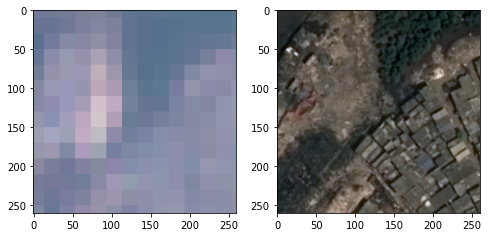

In [45]:
fig, ax = plt.subplots(1,2, figsize=(8,5))
# note that the sentinel data are 16-bit i.e. value range 0-65536, but in this area 
# values are mostly at the lower end, so normalise to 2000 for now.
ax[0].imshow(img_arr_sentinel / 2000.)
ax[1].imshow(img_arr)


In [46]:
img_arr.shape

(260, 260, 3)

In [42]:
lbl_arr = create_label_array(unique_tiles[17000], in_label_file, 'gridcode')

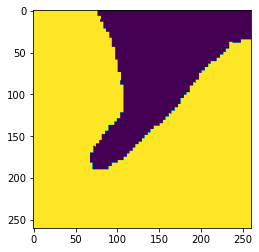

In [43]:
plt.imshow(lbl_arr)

In [47]:
lbl_arr.shape

(260, 260)

In [48]:
lbl_arr.mean()

0.735784023668639

In [49]:
out_folder = r'E:\Temp\airbus_0p5m_2pad'

In [92]:
unique_tiles[0]

DLTile(key='256:8:0.5:43:-1803:16345',
       resolution=0.5,
       tilesize=256,
       pad=8,
       crs='EPSG:32643',
       bounds=(269212.0, 2092156.0, 269348.0, 2092292.0),
       bounds_crs='EPSG:32643',
       geometry=<shapely.geom...001769BECB908>,
       zone=43,
       ti=-1803,
       tj=16345,
       geotrans=[
  269212.0,...
  0,
  -0.5
],
       proj4='+proj=utm +z...s=m +no_defs ',
       wkt='PROJCS["WGS ...SG","32643"]]')

In [51]:
from joblib import Parallel, delayed
import multiprocessing
inputs = list(unique_tiles)#[:100]

Let's create training samples for all our tiles, now. I'm using a 12-core desktop machine, I'll run 20 jobs in parallel. This seems to work fine on a home broadband connection, i.e. the limiting factor is still how fast the api returns the data, so we can get away with running more jobs than there are cores. We use a simple wrapper class to allow us to pass the DLTile object in joblib (it's not otherwise pickleable). 

In [52]:
inputs = [TileJobConfig(t, out_folder, PRODUCT, REF_DATE, in_label_file, 'gridcode') for t in inputs]

In [53]:
len(inputs)

20036

In [ ]:
res = Parallel(n_jobs=20)(delayed(create_chips_for_tile)(t) for t in inputs)

## Plot things on a map so we can see what's up

First create a geopandas dataframe of the tile keys and geometries, which is a format that we can map easily

In [43]:
import geopandas as gpd

In [44]:
tile_geoms = gpd.GeoDataFrame([(t.key, t.geometry) for t in unique_tiles], columns=['tile_key', 'geometry'])
tile_geoms.crs = 'EPSG:4326'

Do the same for the labels (ground truth) file which is currently a shapefile rather than geojson

In [45]:
label_geoms = gpd.read_file(in_label_file)
label_geoms = label_geoms.drop(label_geoms[label_geoms['gridcode']==0].index)

Now add each to an interactive folium map with different colours

In [46]:
import folium

In [47]:
m = folium.Map(location=[19,73], zoom_start=11)

In [48]:
tstyle= {'fillColor': '#0055FFFF', 'color': '#0055FFFF'}
folium.GeoJson(tile_geoms, name='tile boundaries', style_function=lambda x:tstyle).add_to(m)

In [49]:
estyle={'fillColor': '#228B22', 'color': '#228B22'}
folium.GeoJson(extent_polygons, name='extent polygons', style_function=lambda x:estyle).add_to(m)

In [50]:
lstyle={'fillColor': '#FF0000', 'color': '#FF0000'}
folium.GeoJson(label_geoms, name='slum polygons', style_function=lambda x:lstyle).add_to(m)

In [51]:
folium.LayerControl().add_to(m)

In [52]:
m

In [ ]:
# convert classified image folders to tfrecords

def tfrecord_from_img(imgpath):
    labelpath = imgpath.replace('images','labels')
    dl_tile_key = os.path.basename(imgpath).split
infiles = glob.glob(r'E:\Temp\mumbai_esri_train2m\images\*.tif')
len(infiles)